In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

## Data Read In

In [2]:
# def fill_na_prev_px(df, column):
#     for cnt in range(len(df[column])):
#         if pd.isnull(df[column].iloc[cnt]):
#             if cnt == 0:
#                 continue
#             df.loc[df.index[cnt], column] = df[column].iloc[cnt-1]

In [3]:
file = "./EUA DATA 2/EUAfactors.xlsx"

In [4]:
df_prices = pd.read_excel(file, sheet_name="EUA")
df_prices = df_prices.iloc[:, [0, 1]]

exl_file = pd.ExcelFile(file)
for sheet in exl_file.sheet_names:
    if sheet == 'EUA' or sheet == 'EUA PxVolume':
        continue
    df = exl_file.parse(sheet)
    df = df.iloc[:, [0, 1]]
    df["Date"] = pd.to_datetime(df["Date"], errors='coerce')
    df_prices = pd.merge(df_prices, df, on='Date', how='left')

In [5]:
df_prices = df_prices.sort_values(by = "Date", ascending = True).reset_index(drop = True)

In [6]:
df_prices

,Date,MO1 Comdty - Last Price,CO1 Comdty - Last Price,XA1 Comdty - Last Price,NG1 COMB Comdty - Last Price,SPX Index - Last Price,SXXP Index - Last Price,MXEU0EN Index - Last Price,SPGTCED Index - Last Price,CAC Index - Last Price,...,VIX Index - Last Price,EURUSD Curncy - Last Price,EURGBP Curncy - Last Price,EURCHF Curncy - Last Price,EURCNY Curncy - Last Price,EURRUB Curncy - Last Price,ECO Index - Last Price,LP01TREU Index - Last Price,XAU Curncy - Last Price,LBEATREU Index - Last Price
0,2005-04-22,16.85,54.97,NaN,7.195,1152.12,259.27,143.62,1207.11,3980.18,...,15.38,1.3065,0.68246,1.54300,10.8127,36.2193,141.33,137.3557,434.60,150.2700
1,2005-04-25,17.45,54.40,NaN,7.153,1162.10,260.45,145.70,1212.64,3993.07,...,14.62,1.3007,0.68050,1.54385,10.7619,36.0818,142.34,137.5376,434.70,150.4685
2,2005-04-26,17.15,54.14,NaN,7.120,1151.74,259.52,145.84,1212.93,3993.04,...,14.91,1.2985,0.68130,1.54120,10.7464,36.0668,140.29,137.2850,437.10,150.4982
3,2005-04-27,16.35,52.29,NaN,6.748,1156.38,255.99,143.24,1208.46,3927.68,...,14.87,1.2930,0.67851,1.54200,10.7026,35.9000,139.26,137.1641,432.47,150.7594
4,2005-04-28,15.95,52.48,NaN,6.748,1143.22,255.63,143.09,1189.36,3911.45,...,16.86,1.2893,0.67640,1.53825,10.6713,35.8425,136.83,137.2565,431.40,150.8407
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5102,2025-01-27,77.65,77.08,109.10,3.697,6012.28,529.69,150.26,711.38,7906.58,...,17.90,1.0492,0.83944,0.94627,7.6035,102.1907,40.99,NaN,NaN,242.1937
5103,2025-01-28,78.55,77.49,110.25,3.471,6067.70,531.60,150.55,706.47,7897.37,...,16.41,1.0430,0.83828,0.94309,7.4871,102.2253,40.46,NaN,NaN,242.0504
5104,2025-01-29,81.18,76.58,109.95,3.535,6039.31,534.26,150.93,717.55,7872.48,...,16.56,1.0421,0.83697,0.94496,7.4771,103.4377,40.55,NaN,NaN,241.9405
5105,2025-01-30,80.91,76.87,110.00,3.047,6071.17,538.84,153.37,728.44,7941.64,...,15.84,1.0391,0.83683,0.94534,7.4827,102.1367,41.51,NaN,NaN,242.7574


In [7]:
df_prices['Date'] = pd.to_datetime(df_prices['Date'])
df_prices.set_index('Date', inplace=True)
df_prices = df_prices.ffill()

In [8]:
df_prices

,MO1 Comdty - Last Price,CO1 Comdty - Last Price,XA1 Comdty - Last Price,NG1 COMB Comdty - Last Price,SPX Index - Last Price,SXXP Index - Last Price,MXEU0EN Index - Last Price,SPGTCED Index - Last Price,CAC Index - Last Price,DAX Index - Last Price,VIX Index - Last Price,EURUSD Curncy - Last Price,EURGBP Curncy - Last Price,EURCHF Curncy - Last Price,EURCNY Curncy - Last Price,EURRUB Curncy - Last Price,ECO Index - Last Price,LP01TREU Index - Last Price,XAU Curncy - Last Price,LBEATREU Index - Last Price
Date,,,,,,,,,,,,,,,,,,,,
2005-04-22,16.85,54.97,NaN,7.195,1152.12,259.27,143.62,1207.11,3980.18,4223.04,15.38,1.3065,0.68246,1.54300,10.8127,36.2193,141.33,137.3557,434.60,150.2700
2005-04-25,17.45,54.40,NaN,7.153,1162.10,260.45,145.70,1212.64,3993.07,4246.96,14.62,1.3007,0.68050,1.54385,10.7619,36.0818,142.34,137.5376,434.70,150.4685
2005-04-26,17.15,54.14,NaN,7.120,1151.74,259.52,145.84,1212.93,3993.04,4233.76,14.91,1.2985,0.68130,1.54120,10.7464,36.0668,140.29,137.2850,437.10,150.4982
2005-04-27,16.35,52.29,NaN,6.748,1156.38,255.99,143.24,1208.46,3927.68,4189.02,14.87,1.2930,0.67851,1.54200,10.7026,35.9000,139.26,137.1641,432.47,150.7594
2005-04-28,15.95,52.48,NaN,6.748,1143.22,255.63,143.09,1189.36,3911.45,4178.10,16.86,1.2893,0.67640,1.53825,10.6713,35.8425,136.83,137.2565,431.40,150.8407
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-27,77.65,77.08,109.10,3.697,6012.28,529.69,150.26,711.38,7906.58,21282.18,17.90,1.0492,0.83944,0.94627,7.6035,102.1907,40.99,478.9796,2624.50,242.1937
2025-01-28,78.55,77.49,110.25,3.471,6067.70,531.60,150.55,706.47,7897.37,21430.58,16.41,1.0430,0.83828,0.94309,7.4871,102.2253,40.46,478.9796,2624.50,242.0504
2025-01-29,81.18,76.58,109.95,3.535,6039.31,534.26,150.93,717.55,7872.48,21637.53,16.56,1.0421,0.83697,0.94496,7.4771,103.4377,40.55,478.9796,2624.50,241.9405


#### Adding energy prices.

In [9]:
df_energy_prices = pd.read_csv("./EUA DATA 2/european_wholesale_electricity_price_data_daily.csv")

In [10]:
df_energy_prices

,Country,ISO3 Code,Date,Price (EUR/MWhe)
0,Austria,AUT,2015-01-01,22.34
1,Belgium,BEL,2015-01-01,36.56
2,Czechia,CZE,2015-01-01,20.60
3,Denmark,DNK,2015-01-01,15.51
4,Estonia,EST,2015-01-01,24.51
...,...,...,...,...
107594,Slovakia,SVK,2025-01-30,135.24
107595,Slovenia,SVN,2025-01-30,135.86
107596,Spain,ESP,2025-01-30,39.93
107597,Sweden,SWE,2025-01-30,49.77


* What do I do with it? data starts 2015 - I cannot interpolate it before that time.

In [11]:
#df_prices.to_excel("output.xlsx")

### Checking for backwards-adjustment

Typically continous futures data is backwards adjusted on the Bloomberg Terminal.

### Bloomberg Pan-European High Yield Index Month to Date Problem

Suppose the Bloomberg High Yield Index MTD Total Return is +1.2% on November 20:
This means that the high-yield bond market has delivered a 1.2% total return (price changes + coupon payments) from November 1 to November 20.
If it is -0.5%, the market has incurred a 0.5% loss during the same period.

I CANNOT LOG IT

### Initial data plots

In [12]:
# def ts_plotter(df, column, ttl, colors=False):
#     plt.plot(df['Date'], df[column], color='b')
#     plt.xlabel('Date')
#     plt.ylabel('Price')
#     plt.title(ttl)
#     if colors:
#         plt.axvspan(df["Date"].min(), "2007-12-31", color='yellow', alpha=0.3, label="Phase 1")
#         plt.axvspan("2008-01-01", "2012-12-31", color='orange', alpha=0.3, label="Phase 2")
#         plt.axvspan("2013-01-01", "2020-12-31", color='red', alpha=0.3, label="Phase 3")
#         plt.axvspan("2021-01-01", df["Date"].max(), color='green', alpha=0.3, label="Phase 4")
#         plt.legend()

In [13]:
len(df_prices.columns), len(df_prices.columns)/4

(20, 5.0)

In [14]:
# Set graph settings
row_size = 5
col_size = 4
fig_size_x = 10
fig_size_y = 10

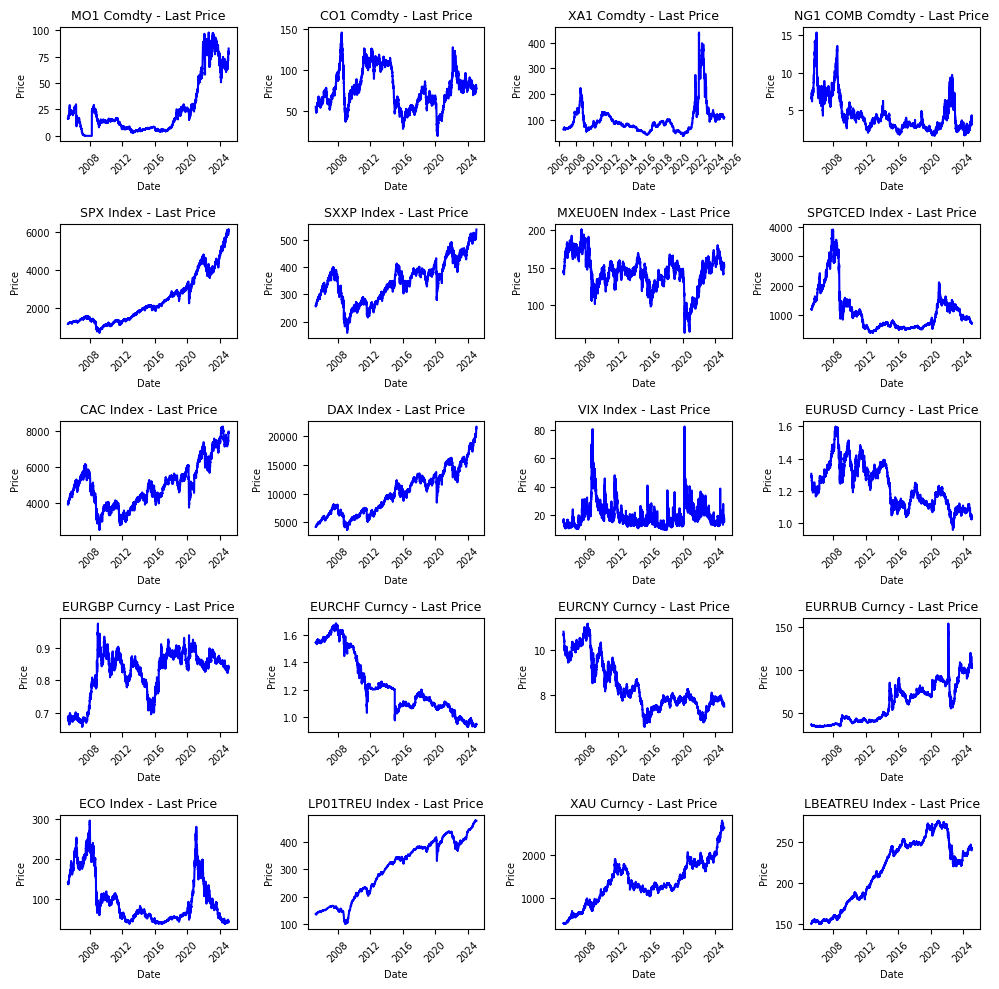

In [15]:
fig, axes = plt.subplots(row_size, col_size, figsize=(fig_size_x, fig_size_y))
axes = axes.flatten()
for i in range(len(df_prices.columns)):
    axes[i].plot(df_prices.index, df_prices[df_prices.columns[i]], color='b')
    axes[i].set_xlabel('Date', fontsize=7)
    axes[i].set_ylabel('Price', fontsize=7)
    axes[i].set_title(df_prices.columns[i], fontsize = 9)
    axes[i].tick_params(axis="x", labelsize=7, rotation=45)
    axes[i].tick_params(axis="y", labelsize=7)
plt.tight_layout()
plt.show()

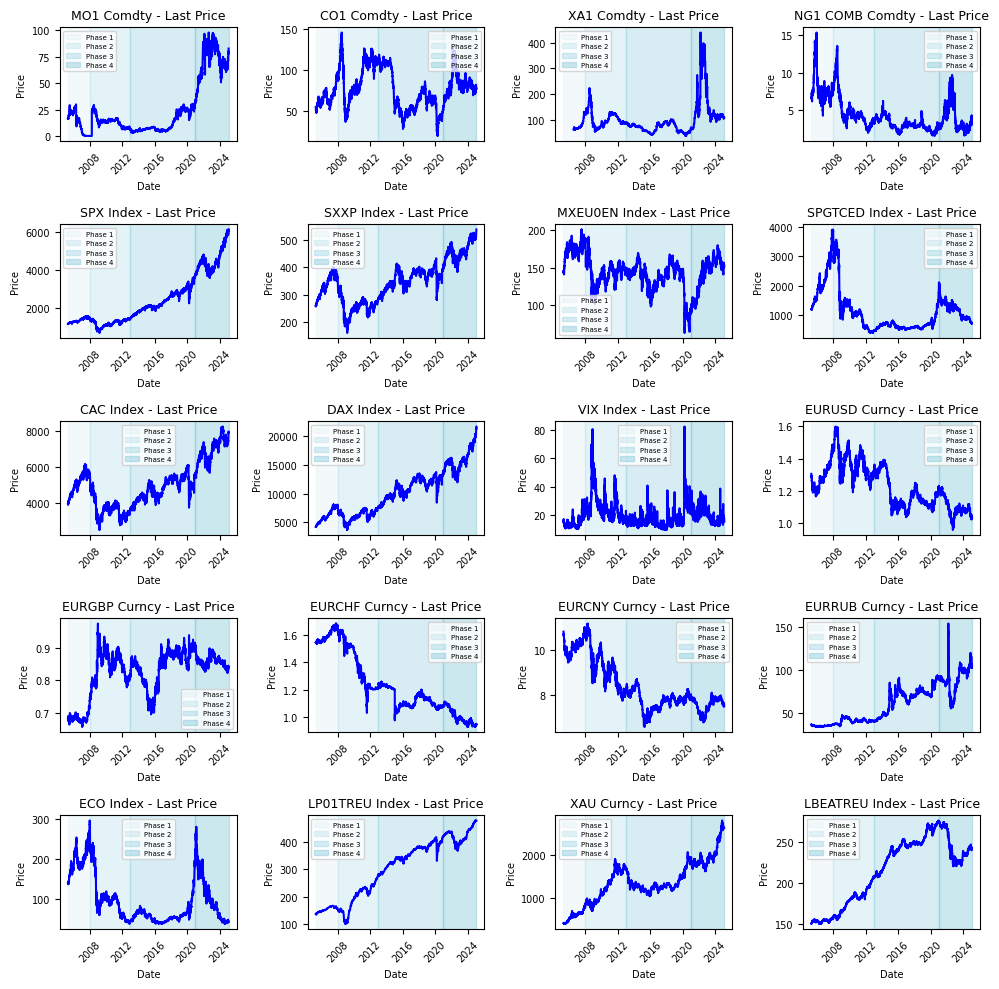

In [16]:
fig, axes = plt.subplots(row_size, col_size, figsize=(fig_size_x, fig_size_y))
axes = axes.flatten()
for i in range(len(df_prices.columns)):
    axes[i].plot(df_prices.index, df_prices[df_prices.columns[i]], color='b')
    axes[i].set_xlabel('Date', fontsize=7)
    axes[i].set_ylabel('Price', fontsize=7)
    axes[i].set_title(df_prices.columns[i], fontsize = 9)
    axes[i].tick_params(axis="x", labelsize=7, rotation=45)
    axes[i].tick_params(axis="y", labelsize=7)
    axes[i].axvspan(df_prices.index.min(), "2007-12-31", color='#D8EDF2', alpha=0.3, label="Phase 1")
    axes[i].axvspan("2008-01-01", "2012-12-31", color='#A8D8E6', alpha=0.3, label="Phase 2")
    axes[i].axvspan("2013-01-01", "2020-12-31", color='#7CC6D9', alpha=0.3, label="Phase 3")
    axes[i].axvspan("2021-01-01", df_prices.index.max(), color='#54B4CC', alpha=0.3, label="Phase 4")
    axes[i].legend(prop={'size': 5})
plt.tight_layout()
plt.show()

* For some reason WIND end in 2016 - it must be dropped.
* The SP Green Bond Index does not start before start of phase 3 - What do we do with it?

The rest of variables seems ok to fit our purpose.

## Standardising to log returns

In [17]:
# We will consider Phase 3 and 4 of data only
df_phase3and4 = df_prices[(df_prices.index >= "2013-01-01")]

In [18]:
df_phase3and4

,MO1 Comdty - Last Price,CO1 Comdty - Last Price,XA1 Comdty - Last Price,NG1 COMB Comdty - Last Price,SPX Index - Last Price,SXXP Index - Last Price,MXEU0EN Index - Last Price,SPGTCED Index - Last Price,CAC Index - Last Price,DAX Index - Last Price,VIX Index - Last Price,EURUSD Curncy - Last Price,EURGBP Curncy - Last Price,EURCHF Curncy - Last Price,EURCNY Curncy - Last Price,EURRUB Curncy - Last Price,ECO Index - Last Price,LP01TREU Index - Last Price,XAU Curncy - Last Price,LBEATREU Index - Last Price
Date,,,,,,,,,,,,,,,,,,,,
2013-01-02,6.40,112.47,89.70,3.233,1462.42,285.33,145.53,468.33,3733.93,7778.78,14.68,1.3186,0.81116,1.21038,8.2776,39.8171,44.04,279.4828,1686.89,208.2821
2013-01-03,6.23,112.14,88.60,3.198,1459.37,286.83,147.09,475.40,3721.17,7756.44,14.56,1.3049,0.81012,1.20939,8.1940,39.5531,45.59,280.7934,1663.99,207.9842
2013-01-04,6.17,111.31,88.50,3.287,1466.47,287.83,148.07,480.68,3730.02,7776.37,13.83,1.3069,0.81309,1.20840,8.1142,39.6434,45.78,281.1628,1656.10,207.5681
2013-01-07,6.49,111.40,87.35,3.266,1461.89,286.63,146.69,477.53,3704.64,7732.66,13.79,1.3117,0.81391,1.20841,8.1138,39.7685,44.73,282.0467,1646.92,207.7236
2013-01-08,6.30,111.94,86.70,3.218,1457.15,286.25,146.42,472.50,3705.88,7695.83,13.62,1.3081,0.81481,1.20886,8.1601,39.6128,44.67,282.8452,1659.13,208.1025
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-27,77.65,77.08,109.10,3.697,6012.28,529.69,150.26,711.38,7906.58,21282.18,17.90,1.0492,0.83944,0.94627,7.6035,102.1907,40.99,478.9796,2624.50,242.1937
2025-01-28,78.55,77.49,110.25,3.471,6067.70,531.60,150.55,706.47,7897.37,21430.58,16.41,1.0430,0.83828,0.94309,7.4871,102.2253,40.46,478.9796,2624.50,242.0504
2025-01-29,81.18,76.58,109.95,3.535,6039.31,534.26,150.93,717.55,7872.48,21637.53,16.56,1.0421,0.83697,0.94496,7.4771,103.4377,40.55,478.9796,2624.50,241.9405


In [19]:
df_phase3and4.isnull().sum()

MO1 Comdty - Last Price         0
CO1 Comdty - Last Price         0
XA1 Comdty - Last Price         0
NG1 COMB Comdty - Last Price    0
SPX Index - Last Price          0
SXXP Index - Last Price         0
MXEU0EN Index - Last Price      0
SPGTCED Index - Last Price      0
CAC Index - Last Price          0
DAX Index - Last Price          0
VIX Index - Last Price          0
EURUSD Curncy - Last Price      0
EURGBP Curncy - Last Price      0
EURCHF Curncy - Last Price      0
EURCNY Curncy - Last Price      0
EURRUB Curncy - Last Price      0
ECO Index - Last Price          0
LP01TREU Index - Last Price     0
XAU Curncy - Last Price         0
LBEATREU Index - Last Price     0
dtype: int64

In [20]:
df_returns = df_phase3and4.copy()
df_returns = np.log(df_returns / df_returns.shift(1)).dropna()

In [21]:
df_returns

,MO1 Comdty - Last Price,CO1 Comdty - Last Price,XA1 Comdty - Last Price,NG1 COMB Comdty - Last Price,SPX Index - Last Price,SXXP Index - Last Price,MXEU0EN Index - Last Price,SPGTCED Index - Last Price,CAC Index - Last Price,DAX Index - Last Price,VIX Index - Last Price,EURUSD Curncy - Last Price,EURGBP Curncy - Last Price,EURCHF Curncy - Last Price,EURCNY Curncy - Last Price,EURRUB Curncy - Last Price,ECO Index - Last Price,LP01TREU Index - Last Price,XAU Curncy - Last Price,LBEATREU Index - Last Price
Date,,,,,,,,,,,,,,,,,,,,
2013-01-03,-0.026922,-0.002938,-0.012339,-0.010885,-0.002088,0.005243,0.010662,0.014983,-0.003423,-0.002876,-0.008208,-0.010444,-0.001283,-0.000818,-0.010151,-0.006652,0.034590,0.004678,-0.013668,-0.001431
2013-01-04,-0.009677,-0.007429,-0.001129,0.027450,0.004853,0.003480,0.006640,0.011045,0.002375,0.002566,-0.051438,0.001532,0.003659,-0.000819,-0.009787,0.002280,0.004159,0.001315,-0.004753,-0.002003
2013-01-07,0.050564,0.000808,-0.013080,-0.006409,-0.003128,-0.004178,-0.009364,-0.006575,-0.006828,-0.005637,-0.002896,0.003666,0.001008,0.000008,-0.000049,0.003151,-0.023203,0.003139,-0.005559,0.000749
2013-01-08,-0.029713,0.004836,-0.007469,-0.014806,-0.003248,-0.001327,-0.001842,-0.010589,0.000335,-0.004774,-0.012404,-0.002748,0.001105,0.000372,0.005690,-0.003923,-0.001342,0.002827,0.007386,0.001822
2013-01-09,-0.040491,-0.001609,0.000000,-0.033173,0.002652,0.006859,0.008433,0.015040,0.003117,0.003197,0.013854,-0.001300,0.000638,0.000066,-0.001779,0.001410,0.017531,0.001984,-0.000904,0.000608
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-27,-0.029190,-0.018255,0.004133,-0.085500,-0.014688,-0.000717,-0.007822,-0.004684,-0.002658,-0.005284,0.186801,-0.000476,-0.001429,-0.004997,0.000171,-0.004517,-0.043677,0.000000,0.000000,0.001849
2025-01-28,0.011524,0.005305,0.010486,-0.063079,0.009176,0.003599,0.001928,-0.006926,-0.001166,0.006949,-0.086910,-0.005927,-0.001383,-0.003366,-0.015427,0.000339,-0.013014,0.000000,0.000000,-0.000592
2025-01-29,0.032934,-0.011813,-0.002725,0.018271,-0.004690,0.004991,0.002521,0.015562,-0.003157,0.009610,0.009099,-0.000863,-0.001564,0.001981,-0.001337,0.011790,0.002222,0.000000,0.000000,-0.000454


In [22]:
df_returns.columns

Index(['MO1 Comdty - Last Price', 'CO1 Comdty - Last Price',
       'XA1 Comdty - Last Price', 'NG1 COMB Comdty - Last Price',
       'SPX Index - Last Price', 'SXXP Index - Last Price',
       'MXEU0EN Index - Last Price', 'SPGTCED Index - Last Price',
       'CAC Index - Last Price', 'DAX Index - Last Price',
       'VIX Index - Last Price', 'EURUSD Curncy - Last Price',
       'EURGBP Curncy - Last Price', 'EURCHF Curncy - Last Price',
       'EURCNY Curncy - Last Price', 'EURRUB Curncy - Last Price',
       'ECO Index - Last Price', 'LP01TREU Index - Last Price',
       'XAU Curncy - Last Price', 'LBEATREU Index - Last Price'],
      dtype='object')

In [23]:
df_returns.to_csv("EUA_log_return_output.csv")

### Descriptive Stats

In [24]:
df_returns.describe()

,MO1 Comdty - Last Price,CO1 Comdty - Last Price,XA1 Comdty - Last Price,NG1 COMB Comdty - Last Price,SPX Index - Last Price,SXXP Index - Last Price,MXEU0EN Index - Last Price,SPGTCED Index - Last Price,CAC Index - Last Price,DAX Index - Last Price,VIX Index - Last Price,EURUSD Curncy - Last Price,EURGBP Curncy - Last Price,EURCHF Curncy - Last Price,EURCNY Curncy - Last Price,EURRUB Curncy - Last Price,ECO Index - Last Price,LP01TREU Index - Last Price,XAU Curncy - Last Price,LBEATREU Index - Last Price
count,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000,3119.000000
mean,0.000820,-0.000123,0.000065,-0.000020,0.000459,0.000205,0.000017,0.000142,0.000242,0.000329,0.000013,-0.000076,0.000010,-0.000079,-0.000033,0.000304,-0.000014,0.000173,0.000142,0.000049
std,0.031220,0.023537,0.025092,0.037004,0.010516,0.009891,0.016135,0.014484,0.011511,0.011647,0.077511,0.004846,0.004697,0.004920,0.004466,0.014591,0.022035,0.002544,0.009232,0.002546
min,-0.432421,-0.279761,-0.536880,-0.300480,-0.127652,-0.121915,-0.199431,-0.124971,-0.130983,-0.130549,-0.330681,-0.023821,-0.019752,-0.207877,-0.021328,-0.125744,-0.162390,-0.038424,-0.095121,-0.012883
25%,-0.014271,-0.010251,-0.004274,-0.018676,-0.003424,-0.004161,-0.007106,-0.006999,-0.005034,-0.004719,-0.041858,-0.002895,-0.002598,-0.001637,-0.002486,-0.004823,-0.011778,-0.000503,-0.004622,-0.001127
50%,0.000741,0.000835,0.000000,0.000000,0.000489,0.000601,0.000418,0.000491,0.000599,0.000614,-0.005183,0.000000,-0.000118,-0.000111,-0.000039,0.000132,0.000337,0.000293,0.000232,0.000102
75%,0.017306,0.011215,0.004761,0.018226,0.005354,0.005288,0.007501,0.007209,0.006071,0.006282,0.033942,0.002721,0.002437,0.001633,0.002436,0.005213,0.011886,0.001119,0.005070,0.001271
max,0.239230,0.190774,0.326216,0.381727,0.089683,0.080704,0.177114,0.110330,0.080561,0.104143,0.768245,0.030158,0.060117,0.029206,0.028812,0.226804,0.133993,0.019676,0.049666,0.017488


Comment: the mean of all instruments is very close to 0, sygnifying a normal distribution, since our data is standardised using log returns.

### Determining Distributions

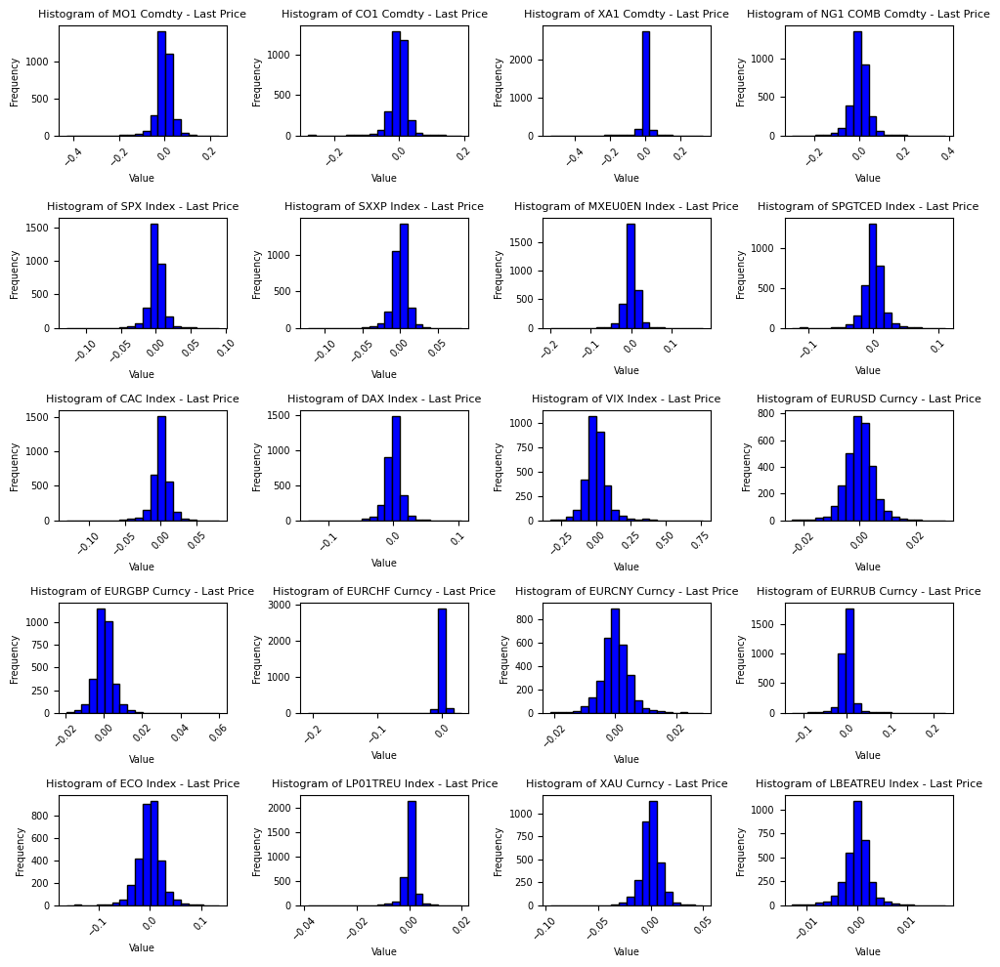

In [25]:
fig, axes = plt.subplots(row_size, col_size, figsize=(fig_size_x, fig_size_y))
axes = axes.flatten()
for i in range(len(df_returns.columns)):
    axes[i].hist(df_returns[df_returns.columns[i]], bins=20, color='b', edgecolor='black')
    axes[i].set_title('Histogram of ' + df_returns.columns[i], fontsize = 8)
    axes[i].set_xlabel('Value', fontsize = 7)
    axes[i].set_ylabel('Frequency', fontsize = 7)
    axes[i].tick_params(axis="x", labelsize=7, rotation=45)
    axes[i].tick_params(axis="y", labelsize=7)
plt.tight_layout()
plt.show()

Comments: On a first look there is a lot of outliers skewing our distribution, however disaccounting their presence the distribution looks normal.

### Boxplots

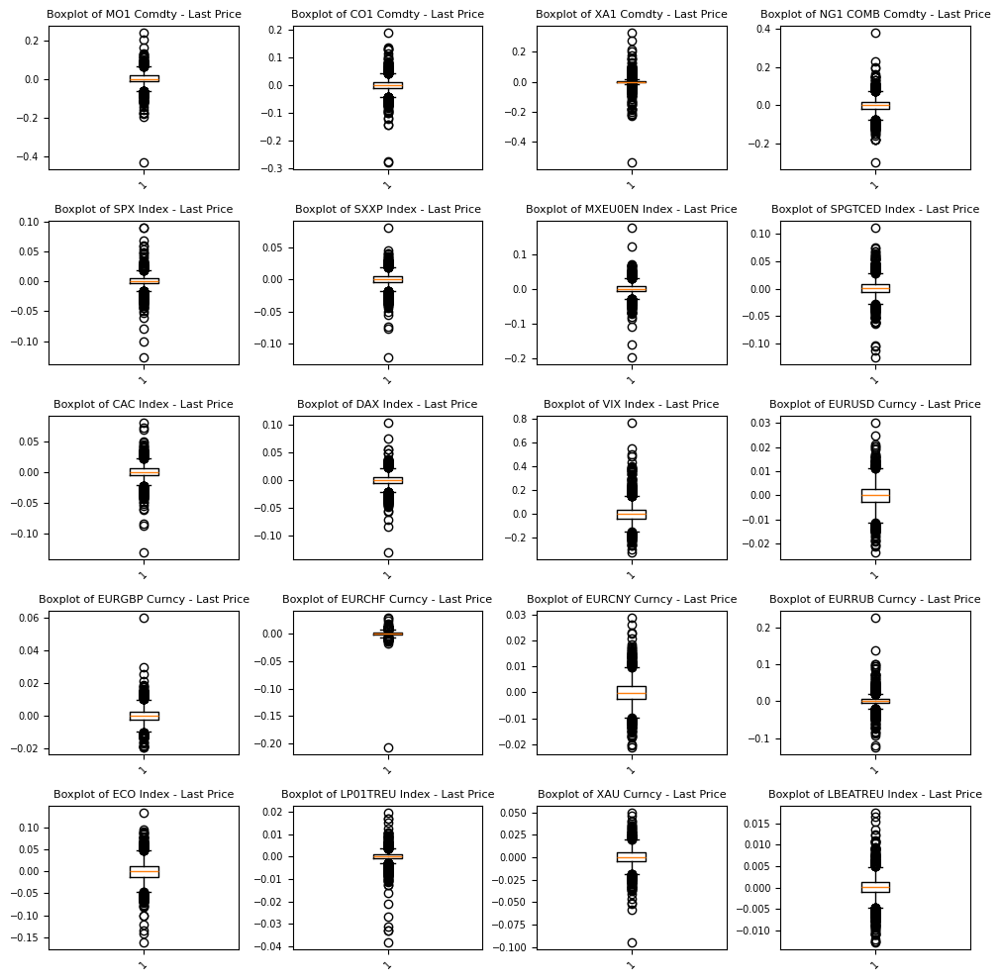

In [26]:
fig, axes = plt.subplots(row_size, col_size, figsize=(fig_size_x, fig_size_y))
axes = axes.flatten()
for i in range(len(df_returns.columns)):
    axes[i].boxplot(df_returns[df_returns.columns[i]])
    axes[i].set_title('Boxplot of ' + df_returns.columns[i], fontsize = 8)
    axes[i].tick_params(axis="x", labelsize=7, rotation=45)
    axes[i].tick_params(axis="y", labelsize=7)
plt.tight_layout()
plt.show()

### Skew and Kurtosis

In [27]:
from scipy.stats import skew, kurtosis

In [28]:
skew_list = []
kurt_list = []

for i in df_returns.columns:
    skew_list.append(skew(df_returns[i]))
    kurt_list.append(kurtosis(df_returns[i]))

In [29]:
pivot = pd.DataFrame({"Skewness": skew_list,
                     "Kurtosis": kurt_list},
                     index=df_returns.columns)
print(pivot)

                               Skewness     Kurtosis
MO1 Comdty - Last Price       -0.977310    16.400362
CO1 Comdty - Last Price       -0.952986    17.207842
XA1 Comdty - Last Price       -2.833420    98.619576
NG1 COMB Comdty - Last Price   0.187395     7.762755
SPX Index - Last Price        -0.829852    17.050680
SXXP Index - Last Price       -1.047465    12.958106
MXEU0EN Index - Last Price    -0.610668    18.897503
SPGTCED Index - Last Price    -0.348441     7.760190
CAC Index - Last Price        -0.794803    10.756913
DAX Index - Last Price        -0.591785    10.448993
VIX Index - Last Price         1.298469     7.804270
EURUSD Curncy - Last Price     0.072895     2.129013
EURGBP Curncy - Last Price     0.864767    10.399472
EURCHF Curncy - Last Price   -23.990205  1019.552525
EURCNY Curncy - Last Price     0.201144     2.861487
EURRUB Curncy - Last Price     1.297799    31.984369
ECO Index - Last Price        -0.219337     3.806029
LP01TREU Index - Last Price   -3.625724    52.

Comment: Skewness metrics suggest that the distribution is not normal in most cases and that there can be a good influence of extreme values on either sides. Kurtosis suggest for most variables that they have heavy tails and a sharper peak, therefore deviating from a normal distribution of 3, which we can see looking back at the histograms.

### Rolling stats

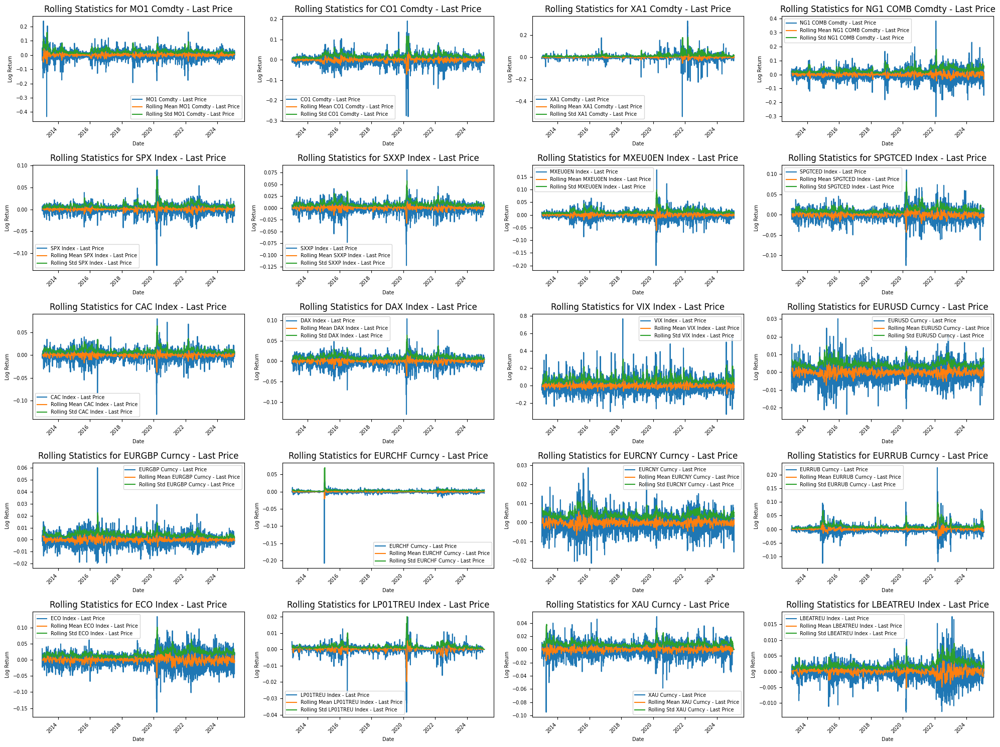

In [30]:
df_rolling_stats = df_returns.copy()

fig, axes = plt.subplots(row_size, col_size, figsize=(20, 15))
axes = axes.flatten()
for i in range(len(df_rolling_stats.columns)):
    df_rolling_stats['Rolling Mean ' + df_rolling_stats.columns[i]] = df_rolling_stats[df_rolling_stats.columns[i]].rolling(window=10).mean()
    df_rolling_stats['Rolling Std ' + df_rolling_stats.columns[i]] = df_rolling_stats[df_rolling_stats.columns[i]].rolling(window=10).std()

    df_rolling_stats[[df_rolling_stats.columns[i], 'Rolling Mean ' + df_rolling_stats.columns[i], 'Rolling Std ' + df_rolling_stats.columns[i]]].plot(ax=axes[i])
    axes[i].set_title('Rolling Statistics for ' + df_rolling_stats.columns[i], fontsize = 12)
    axes[i].set_xlabel('Date', fontsize = 7)
    axes[i].set_ylabel('Log Return', fontsize = 7)
    axes[i].tick_params(axis="x", labelsize=7, rotation=45)
    axes[i].tick_params(axis="y", labelsize=7)
    axes[i].legend(prop={'size': 7})
plt.tight_layout()
plt.show()

Comment: There is no apparent trend in any of those variables, however there are moments of high volatility as shown by the variance and its peaks.

### Testing normality

In [31]:
from scipy.stats import shapiro

In [32]:
stat_list = []
p_val_list = []
normal_list = []

for i in df_returns.columns:
    stat, p = shapiro(df_returns[i])
    stat_list.append(stat)
    p_val_list.append(p)
    if p > 0.05:
        normal_list.append(True)
    else:
        normal_list.append(False)

In [33]:
pivot = pd.DataFrame({"Statistic": stat_list,
                     "p-value": p_val_list, "Normal": normal_list},
                     index=df_returns.columns)
print(pivot)

                              Statistic       p-value  Normal
MO1 Comdty - Last Price        0.912107  3.274982e-39   False
CO1 Comdty - Last Price        0.889417  1.140558e-42   False
XA1 Comdty - Last Price        0.557621  8.852165e-67   False
NG1 COMB Comdty - Last Price   0.938813  4.570521e-34   False
SPX Index - Last Price         0.873918  1.032229e-44   False
SXXP Index - Last Price        0.910995  2.137479e-39   False
MXEU0EN Index - Last Price     0.884436  2.378962e-43   False
SPGTCED Index - Last Price     0.929153  4.200131e-36   False
CAC Index - Last Price         0.918871  4.844170e-38   False
DAX Index - Last Price         0.923825  3.917040e-37   False
VIX Index - Last Price         0.919023  5.157812e-38   False
EURUSD Curncy - Last Price     0.981210  6.450620e-20   False
EURGBP Curncy - Last Price     0.948491  9.404836e-32   False
EURCHF Curncy - Last Price     0.470056  2.497500e-70   False
EURCNY Curncy - Last Price     0.971333  1.611144e-24   False
EURRUB C

Comment: None of the variables have been found to be normally distributed using the wilk-shapiro test. 

### Autocorrelation

#### Autocorr Func

In [34]:
from pandas.plotting import autocorrelation_plot

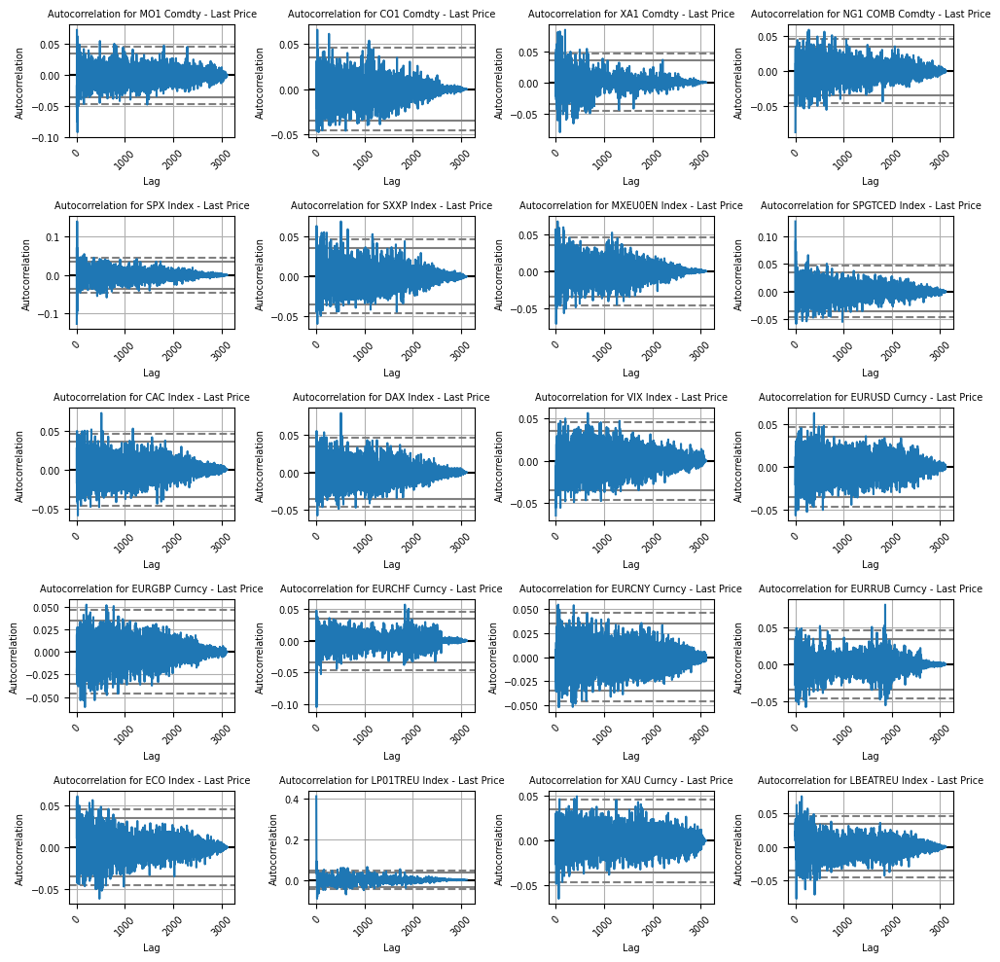

In [35]:
fig, axes = plt.subplots(row_size, col_size, figsize=(fig_size_x, fig_size_y))
axes = axes.flatten()
for i in range(len(df_returns.columns)):
    autocorrelation_plot(df_returns[df_returns.columns[i]], ax=axes[i])
    axes[i].set_title('Autocorrelation for ' + df_returns.columns[i], fontsize=7)
    axes[i].set_xlabel('Lag', fontsize = 7)
    axes[i].set_ylabel('Autocorrelation', fontsize = 7)
    axes[i].tick_params(axis="x", labelsize=7, rotation=45)
    axes[i].tick_params(axis="y", labelsize=7)
plt.tight_layout()
plt.show()

There are lags that for some variables go out of bounds, especially shorter term, with noise cancelling out longer term.

#### ACF plot

In [36]:
from statsmodels.graphics.tsaplots import plot_acf

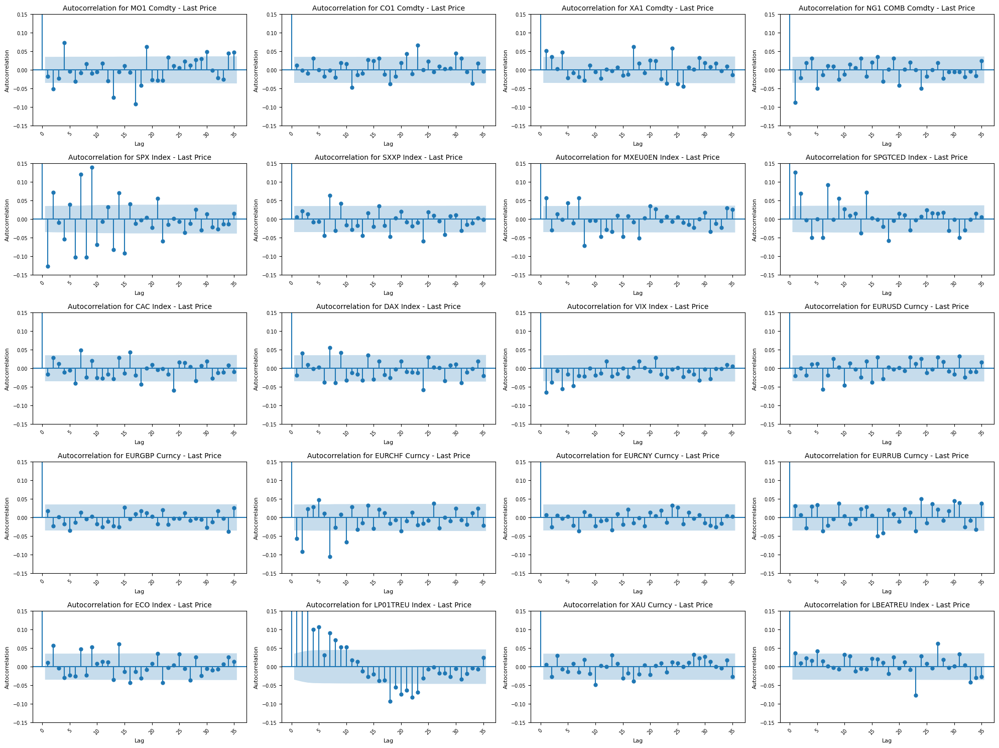

In [37]:
fig, axes = plt.subplots(row_size, col_size, figsize=(20, 15))
axes = axes.flatten()
for i in range(len(df_returns.columns)):
    plot_acf(df_returns[df_returns.columns[i]], ax=axes[i])
    axes[i].set_title('Autocorrelation for ' + df_returns.columns[i], fontsize=10)
    axes[i].set_xlabel('Lag', fontsize = 8)
    axes[i].set_ylabel('Autocorrelation', fontsize = 8)
    axes[i].tick_params(axis="x", labelsize=7, rotation=45)
    axes[i].tick_params(axis="y", labelsize=7)
    axes[i].set_ylim(-0.15, 0.15)
plt.tight_layout()
plt.show()

### Correlation

<Axes: >

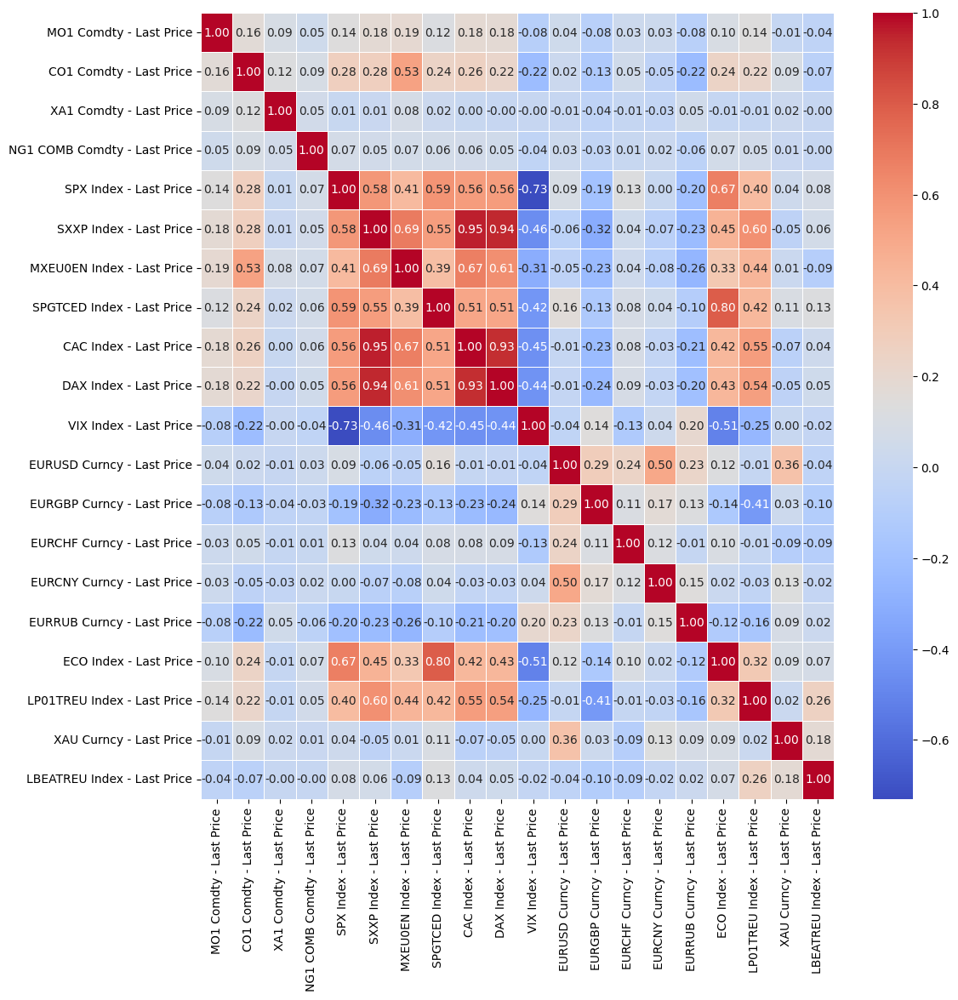

In [38]:
plt.figure(figsize=(12, 12))
sns.heatmap(df_returns.corr(), annot=True, cmap='coolwarm', linewidths=0.5, fmt=".2f", cbar=True)

As an initial look in correlations between asset classes and indexes:
* Our dependant variable is highly correlated with the SP 500 index, STOXX 600 index and european markets, as well as the SP Global Clean Energy Index.
* From commodities, only natural gas has a strong correlation with EUAs.
* Theres a strong correlation between all the US and Europen stock indexes, to a lesser extend with the SP Clean Energy.
* Strong negative correlation of stock indexes and the EUR/USD FX.
* The currencies themselves are strongly correlated, however USD vs. SAR comes to no suprise as the Saudi currency is pegged to the dollar. 

### Rolling Correlation

In [39]:
df_roll_corr = df_returns.copy()

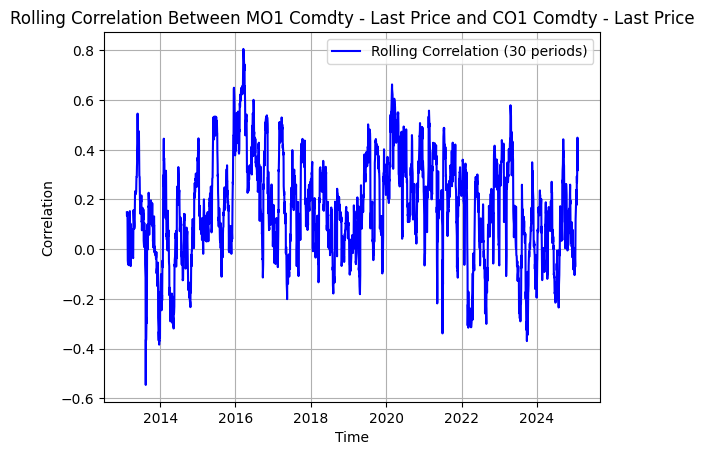

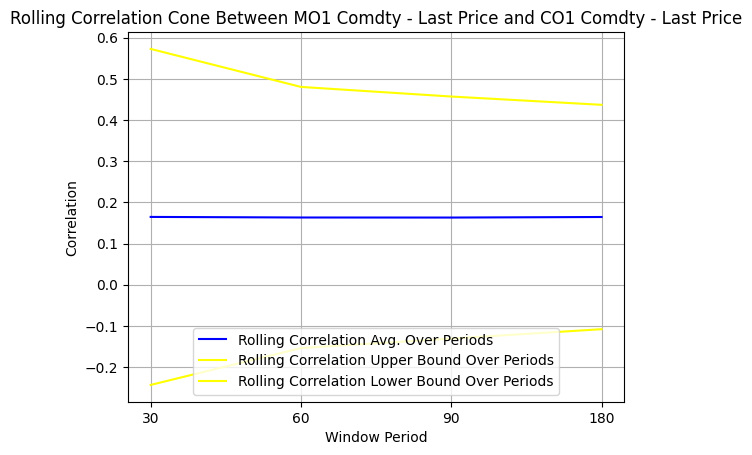

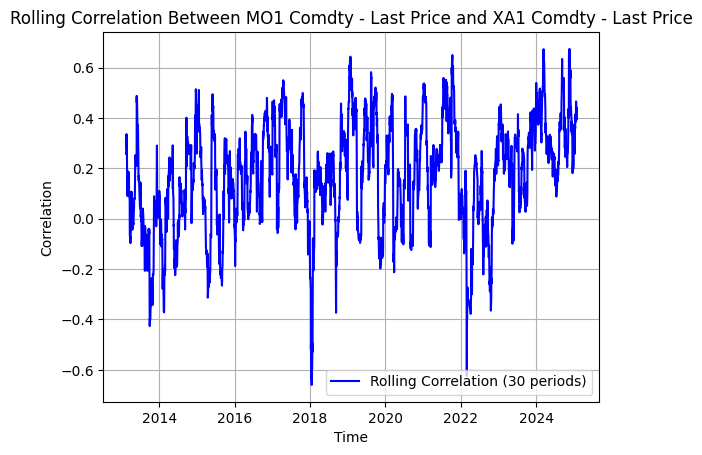

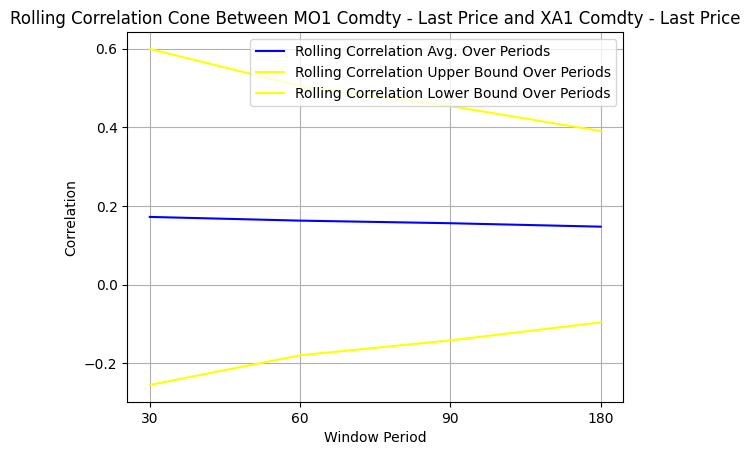

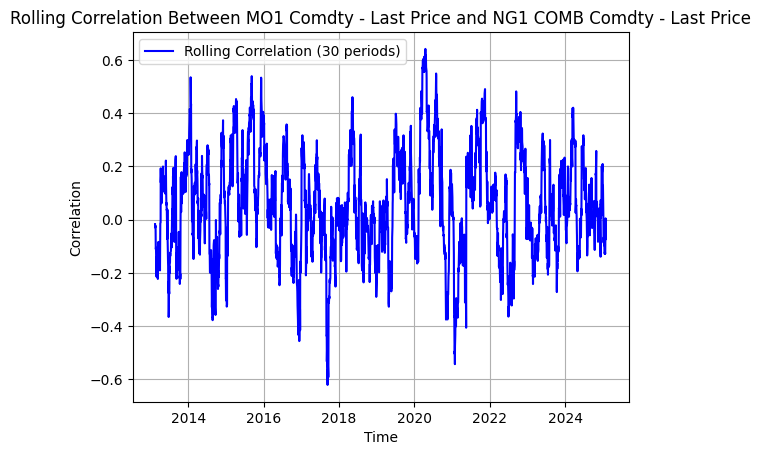

...

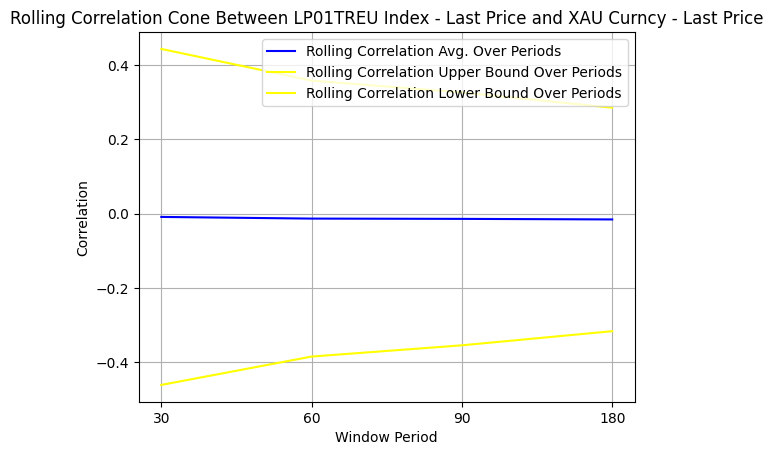

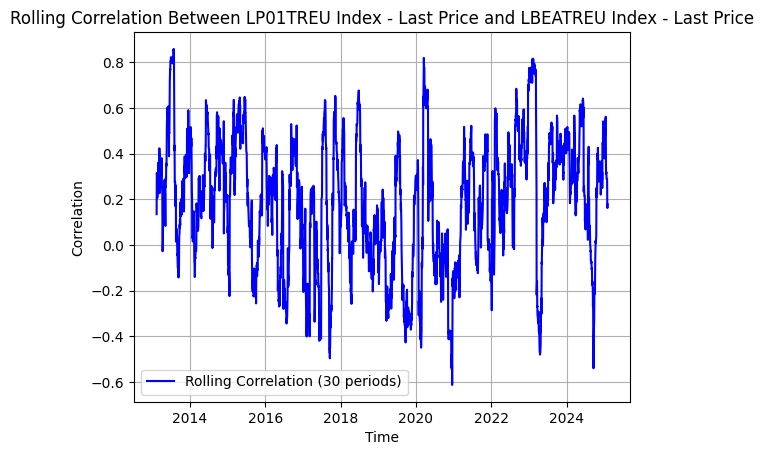

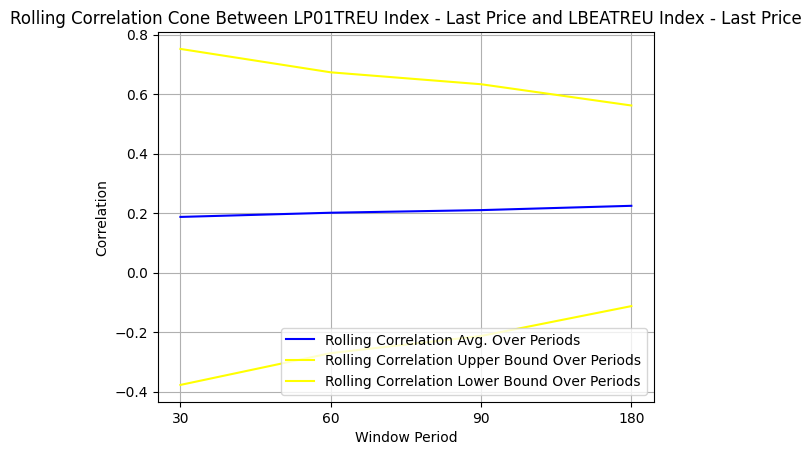

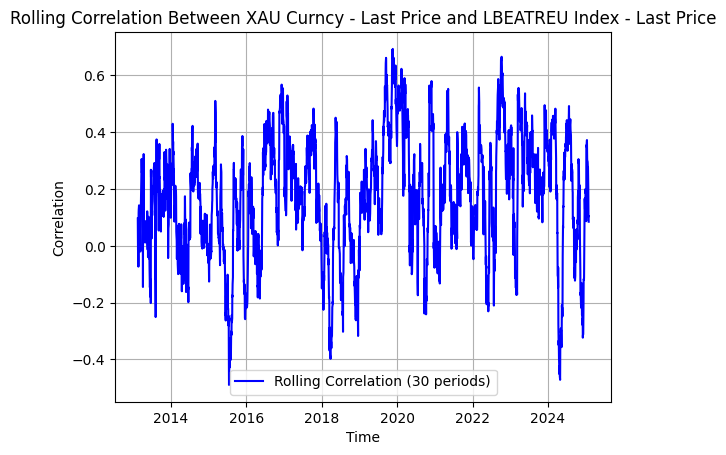

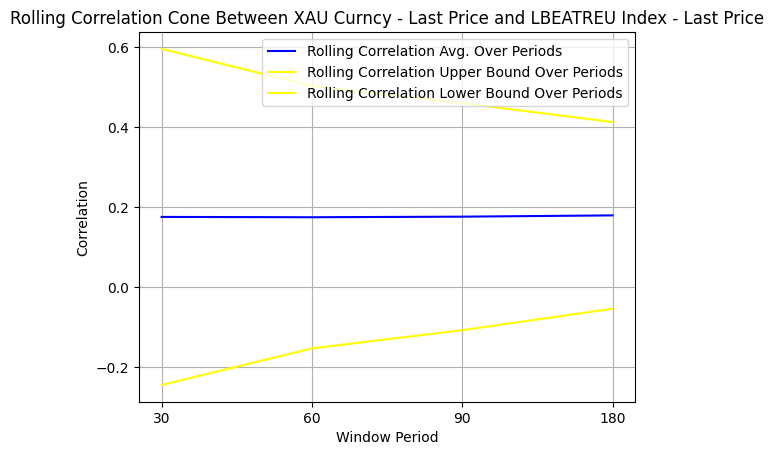

In [40]:
late_start = 1
for i in range(len(df_roll_corr.columns)):
    for j in range(late_start, len(df_roll_corr.columns)):
        rolling_corr_30 = df_roll_corr[df_roll_corr.columns[i]].rolling(window=30).corr(df_roll_corr[df_roll_corr.columns[j]])
        rolling_corr_60 = df_roll_corr[df_roll_corr.columns[i]].rolling(window=60).corr(df_roll_corr[df_roll_corr.columns[j]])
        rolling_corr_90 = df_roll_corr[df_roll_corr.columns[i]].rolling(window=90).corr(df_roll_corr[df_roll_corr.columns[j]])
        rolling_corr_180 = df_roll_corr[df_roll_corr.columns[i]].rolling(window=180).corr(df_roll_corr[df_roll_corr.columns[j]])

        #plt.figure(figsize=(10, 6))
        plt.plot(rolling_corr_30, label='Rolling Correlation (30 periods)', color='blue')
        #plt.plot(rolling_corr_60, label='Rolling Correlation (60 periods)', color='red')
        #plt.plot(rolling_corr_90, label='Rolling Correlation (90 periods)', color='green')
        #plt.plot(rolling_corr_180, label='Rolling Correlation (180 periods)', color='yellow')
        plt.title('Rolling Correlation Between ' + df_roll_corr.columns[i] + ' and ' + df_roll_corr.columns[j])
        plt.xlabel('Time')
        plt.ylabel('Correlation')
        plt.legend()
        plt.grid(True)
        plt.show()

        k = 2
        rolling_avg = [rolling_corr_30.mean(), rolling_corr_60.mean(), rolling_corr_90.mean(), rolling_corr_180.mean()]
        rolling_std_upper = [rolling_avg[0] + k * rolling_corr_30.std(), rolling_avg[1] + k * rolling_corr_60.std(),
                             rolling_avg[2] + k * rolling_corr_90.std(), rolling_avg[3] + k * rolling_corr_180.std()]
        rolling_std_lower = [rolling_avg[0] - k * rolling_corr_30.std(), rolling_avg[1] - k * rolling_corr_60.std(),
                             rolling_avg[2] - k * rolling_corr_90.std(), rolling_avg[3] - k * rolling_corr_180.std()]
        #plt.figure(figsize=(10, 6))
        plt.plot(rolling_avg, label='Rolling Correlation Avg. Over Periods', color='blue')
        plt.plot(rolling_std_upper, label='Rolling Correlation Upper Bound Over Periods', color='yellow')
        plt.plot(rolling_std_lower, label='Rolling Correlation Lower Bound Over Periods', color='yellow')
        plt.title('Rolling Correlation Cone Between ' + df_roll_corr.columns[i] + ' and ' + df_roll_corr.columns[j])
        plt.xlabel('Window Period')
        plt.xticks([0, 1, 2, 3], labels=['30', '60', '90', '180'])
        plt.ylabel('Correlation')
        plt.legend()
        plt.grid(True)
        plt.show()
    late_start += 1

### Stationarity

In [41]:
from statsmodels.tsa.stattools import kpss

In [42]:
kpss_list = []
p_val_list = []
lag_list = []
crit_val_list = []
stationary_list = []

for i in df_returns.columns:
    kpss_stat, p_val, lags, critical_values = kpss(df_returns[i])
    kpss_list.append(kpss_stat)
    p_val_list.append(p_val)
    lag_list.append(lags)
    crit_val_list.append(critical_values)
    if p_val > 0.05:
        stationary_list.append(True)
    else:
        stationary_list.append(False)

/var/folders/mq/fwlcfkh5473f1v14fcsfsgq80000gn/T/ipykernel_15386/1143973827.py:8: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat, p_val, lags, critical_values = kpss(df_returns[i])
/var/folders/mq/fwlcfkh5473f1v14fcsfsgq80000gn/T/ipykernel_15386/1143973827.py:8: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat, p_val, lags, critical_values = kpss(df_returns[i])
/var/folders/mq/fwlcfkh5473f1v14fcsfsgq80000gn/T/ipykernel_15386/1143973827.py:8: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat, p_val, lags, critical_values = kpss(df_returns[i])
/var/folders/mq/fwlcfkh5473f1v14fcsfsgq80000gn/T/ipykernel_15

In [43]:
pivot = pd.DataFrame({"Statistic": kpss_list,
                     "p-value": p_val_list, "Lags": lag_list, #"critical_val": crit_val_list, 
                      "Stationary": stationary_list},
                     index=df_returns.columns)
print(pivot)

                              Statistic   p-value  Lags  Stationary
MO1 Comdty - Last Price        0.099152  0.100000     5        True
CO1 Comdty - Last Price        0.116473  0.100000     5        True
XA1 Comdty - Last Price        0.097830  0.100000     8        True
NG1 COMB Comdty - Last Price   0.033683  0.100000    10        True
SPX Index - Last Price         0.030024  0.100000     3        True
SXXP Index - Last Price        0.026135  0.100000     1        True
MXEU0EN Index - Last Price     0.047607  0.100000     9        True
SPGTCED Index - Last Price     0.203959  0.100000     3        True
CAC Index - Last Price         0.017166  0.100000     0        True
DAX Index - Last Price         0.041913  0.100000     5        True
VIX Index - Last Price         0.011431  0.100000    21        True
EURUSD Curncy - Last Price     0.058616  0.100000     2        True
EURGBP Curncy - Last Price     0.060046  0.100000    12        True
EURCHF Curncy - Last Price     0.033722  0.10000

In [44]:
from statsmodels.tsa.stattools import adfuller

In [45]:
adf_list = []
p_val_list = []
stationary_list = []

for i in df_returns.columns:
    adf_result = adfuller(df_returns[i])
    adf_list.append(adf_result[0])
    p_val_list.append(adf_result[1])
    if adf_result[1] <= 0.05:
        stationary_list.append(True)
    else:
        stationary_list.append(False)

In [46]:
pivot = pd.DataFrame({"Statistic": adf_list,
                     "p-value": p_val_list,
                      "Stationary": stationary_list},
                     index=df_returns.columns)
print(pivot)

                              Statistic       p-value  Stationary
MO1 Comdty - Last Price      -15.359892  3.624506e-28        True
CO1 Comdty - Last Price      -10.562908  7.646351e-19        True
XA1 Comdty - Last Price      -11.166166  2.710988e-20        True
NG1 COMB Comdty - Last Price -25.726387  0.000000e+00        True
SPX Index - Last Price       -12.336733  6.248712e-23        True
SXXP Index - Last Price      -11.944996  4.451664e-22        True
MXEU0EN Index - Last Price   -13.473938  3.340506e-25        True
SPGTCED Index - Last Price   -12.937578  3.590804e-24        True
CAC Index - Last Price       -12.863044  5.062588e-24        True
DAX Index - Last Price       -17.570660  4.053090e-30        True
VIX Index - Last Price       -23.186225  0.000000e+00        True
EURUSD Curncy - Last Price   -18.845534  0.000000e+00        True
EURGBP Curncy - Last Price   -40.044723  0.000000e+00        True
EURCHF Curncy - Last Price   -18.472426  2.138941e-30        True
EURCNY Cur

Comment: There is strong evidence to suggest the data is stationary.

### Decomposition + White Noise 

#### Additive

In [47]:
# from statsmodels.tsa.seasonal import seasonal_decompose
# from statsmodels.graphics.tsaplots import plot_acf

In [48]:
# for i in df_log_returns.columns:
#     if i == "Date":
#         continue
#     result = seasonal_decompose(df_log_returns[i], model='additive', period=5)
#     result.plot()
    
#     white_noise = result.resid
#     white_noise_clean = white_noise.dropna()
#     plot_acf(white_noise_clean, lags=30)
#     #plt.ylim(-0.15, 0.15)
#     plt.title("White Noise: " + i)
#     plt.show()

#### Multiplicative

In [49]:
# for i in df_log_returns.columns:
#     if i == "Date":
#         continue
#     result = seasonal_decompose(df_log_returns[i], model='multiplicative', period=12)
#     result.plot()

Not possible due to 0 and neg values.

#### STL 

Warning: this analysis is on weekly aggregated average log return.

In [50]:
from statsmodels.tsa.seasonal import STL

In [51]:
df_log_ret_STL = df_returns.copy()
# df_log_ret_STL['Date'] = pd.to_datetime(df_log_ret_STL['Date'])

# # Set the 'Date' column as the index
# df_log_ret_STL.set_index('Date', inplace=True)

In [52]:
df_log_ret_STL = df_log_ret_STL.resample('W').mean().ffill()

In [53]:
# for i in df_returns.columns:
#     stl = STL(df_log_ret_STL[i])
#     result = stl.fit()
#     result.plot()

#     white_noise = result.resid
#     white_noise_clean = white_noise.dropna()
#     plot_acf(white_noise_clean, lags=30)
#     #plt.ylim(-0.15, 0.15)
#     plt.title("White Noise: " + i)
#     plt.show()

### EUA spread

In [54]:
df_eua_bid = pd.read_excel("./EUA DATA/EUA_askBid_12_11.xlsx", sheet_name="BID")
df_eua_ask = pd.read_excel("./EUA DATA/EUA_askBid_12_11.xlsx", sheet_name="ASK")

In [55]:
df_eua_bid = df_eua_bid.drop(df_eua_bid.columns[[2, 3, 4, 5]], axis = 1)
df_eua_ask = df_eua_ask.drop(df_eua_ask.columns[[2, 3, 4, 5]], axis = 1)

In [56]:
df_eua_bid

,Date,MO1 Comdty - Bid Price
0,2024-11-12,67.14
1,2024-11-11,67.60
2,2024-11-08,67.69
3,2024-11-07,66.21
4,2024-11-06,64.05
...,...,...
4822,2005-04-28,NaN
4823,2005-04-27,NaN
4824,2005-04-26,NaN
4825,2005-04-25,NaN


In [57]:
df_eua_spread = pd.merge(df_eua_bid, df_eua_ask, on='Date', how='left')

In [58]:
df_eua_spread

,Date,MO1 Comdty - Bid Price,MO1 Comdty - Ask Price
0,2024-11-12,67.14,67.16
1,2024-11-11,67.60,67.69
2,2024-11-08,67.69,67.70
3,2024-11-07,66.21,66.28
4,2024-11-06,64.05,64.09
...,...,...,...
4822,2005-04-28,NaN,NaN
4823,2005-04-27,NaN,NaN
4824,2005-04-26,NaN,NaN
4825,2005-04-25,NaN,NaN


In [59]:
df_eua_spread["Bid/Ask Spread"] = df_eua_spread["MO1 Comdty - Ask Price"] - df_eua_spread["MO1 Comdty - Bid Price"]

In [60]:
df_eua_spread.isnull().sum()

Date                         0
MO1 Comdty - Bid Price    2766
MO1 Comdty - Ask Price    2775
Bid/Ask Spread            2821
dtype: int64

Text(0.5, 1.0, 'EUA Bid/Ask Spread')

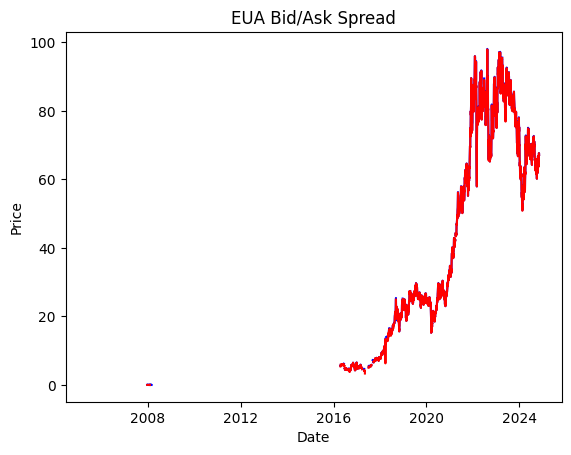

In [61]:
plt.plot(df_eua_spread['Date'], df_eua_spread["MO1 Comdty - Ask Price"], color='b')
plt.plot(df_eua_spread['Date'], df_eua_spread["MO1 Comdty - Bid Price"], color='r')
plt.xlabel('Date')
plt.ylabel('Price')
plt.title("EUA Bid/Ask Spread")
# if colors:
#     plt.axvspan(df["Date"].min(), "2007-12-31", color='yellow', alpha=0.3, label="Phase 1")
#     plt.axvspan("2008-01-01", "2012-12-31", color='orange', alpha=0.3, label="Phase 2")
#     plt.axvspan("2013-01-01", "2020-12-31", color='red', alpha=0.3, label="Phase 3")
#     plt.axvspan("2021-01-01", df["Date"].max(), color='green', alpha=0.3, label="Phase 4")
#     plt.legend()

Text(0.5, 1.0, 'EUA Bid/Ask Spread')

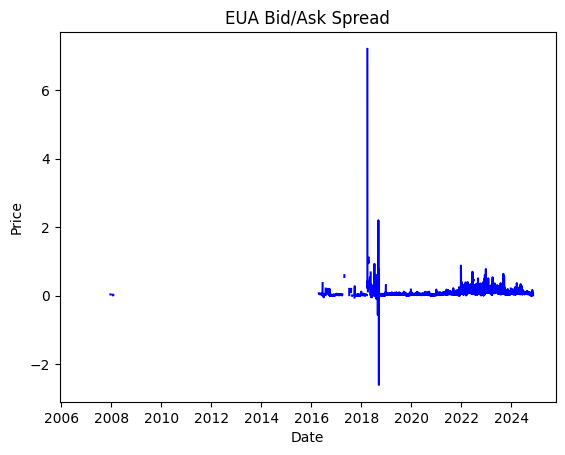

In [62]:
plt.plot(df_eua_spread['Date'], df_eua_spread["Bid/Ask Spread"], color='b')
plt.xlabel('Date')
plt.ylabel('Price')
plt.title("EUA Bid/Ask Spread")

Bid/Ask data cannoty be deemed credible, theres too little data and it shows unexplainable patterns.

In [63]:
df_eua_spread.describe()

,Date,MO1 Comdty - Bid Price,MO1 Comdty - Ask Price,Bid/Ask Spread
count,4827,2061.000000,2052.000000,2006.000000
mean,2015-05-31 02:13:56.793039104,43.138176,43.213942,0.094078
min,2005-04-22 00:00:00,0.010000,0.010000,-2.600000
25%,2010-11-08 12:00:00,19.440000,19.727500,0.030000
50%,2015-07-10 00:00:00,28.960000,29.085000,0.060000
75%,2020-03-14 12:00:00,71.120000,71.272500,0.110000
max,2024-11-12 00:00:00,97.940000,98.110000,7.200000
std,NaN,29.569190,29.687748,0.215031


### Linear Regression Model / LASSO

In [64]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

In [65]:
X = df_returns.drop(["MO1 Comdty - Last Price"], axis = 1)
y = df_returns["MO1 Comdty - Last Price"]

In [66]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1234)

In [67]:
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression()

In [68]:
y_pred = model.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
mse, r2

(np.float64(0.0009723110260342854), 0.03837385371857627)

In [69]:
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV

In [70]:
param_grid = {'alpha': np.logspace(-4, 2, 50)}

grid_search_lasso = GridSearchCV(Lasso(), param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search_lasso.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': array([1.00000000e-04, 1.32571137e-04, 1.75751062e-04, 2.32995181e-04,
       3.08884360e-04, 4.09491506e-04, 5.42867544e-04, 7.19685673e-04,
       9.54095476e-04, 1.26485522e-03, 1.67683294e-03, 2.22299648e-03,
       2.94705170e-03, 3.90693994e-03, 5.17947468e-03, 6.86648845e-03,
       9.10298178e-03, 1.20679264e-02, 1.59985872e-02, 2....
       2.68269580e-01, 3.55648031e-01, 4.71486636e-01, 6.25055193e-01,
       8.28642773e-01, 1.09854114e+00, 1.45634848e+00, 1.93069773e+00,
       2.55954792e+00, 3.39322177e+00, 4.49843267e+00, 5.96362332e+00,
       7.90604321e+00, 1.04811313e+01, 1.38949549e+01, 1.84206997e+01,
       2.44205309e+01, 3.23745754e+01, 4.29193426e+01, 5.68986603e+01,
       7.54312006e+01, 1.00000000e+02])},
             scoring='neg_mean_squared_error')

In [71]:
print("Best alpha:", grid_search_lasso.best_params_)

best_lasso = grid_search_lasso.best_estimator_

Best alpha: {'alpha': np.float64(0.0001)}


In [72]:
y_pred = best_lasso.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

In [73]:
mse, r2

(np.float64(0.0010075753785546988), 0.003497026749302523)